# CartoonGAN

In [1]:
# Import libraries and files
import time
import os
import numpy as np
from PIL import Image
import torch
import torchvision.transforms as transforms
from torch.autograd import Variable
from network.Transformer import Transformer
from tqdm import tqdm_notebook

In [2]:
# Function to process images
def transform(models, style, input, load_size=450, gpu=-1):
    model = models[style]

    if gpu > -1:
        model.cuda()
    else:
        model.float()

    input_image = Image.open(input).convert("RGB")
    h, w = input_image.size

    ratio = h * 1.0 / w

    if ratio > 1:
        h = load_size
        w = int(h * 1.0 / ratio)
    else:
        w = load_size
        h = int(w * ratio)

    input_image = input_image.resize((h, w), Image.BICUBIC)
    input_image = np.asarray(input_image)

    # Convert image to RGB to BGR
    input_image = input_image[:, :, [2, 1, 0]]
    input_image = transforms.ToTensor()(input_image).unsqueeze(0)

    input_image = -1 + 2 * input_image
    if gpu > -1:
        input_image = Variable(input_image).cuda()
    else:
        input_image = Variable(input_image).float()

    t0 = time.time()
    print("input shape", input_image.shape)
    with torch.no_grad():
        output_image = model(input_image)[0]
    print(f"inference time took {time.time() - t0} s")

    output_image = output_image[[2, 1, 0], :, :]
    output_image = output_image.data.cpu().float() * 0.5 + 0.5

    output_image = output_image.numpy()

    output_image = np.uint8(output_image.transpose(1, 2, 0) * 255)
    output_image = Image.fromarray(output_image)

    return output_image

In [3]:
styles = ["Hosoda", "Hayao", "Shinkai", "Paprika"]
models = {}

for style in tqdm_notebook(styles):
    file_path = os.path.abspath('pretrained_models/' + style + '_net_G_float.pth')
    if os.path.exists(file_path):
        model = Transformer()
        model.load_state_dict(torch.load(file_path))
        model.eval()
        models[style] = model
    else:
        print(f"File not found: {file_path}")

C:\Users\yuyla\AppData\Local\Temp\ipykernel_11040\2543900342.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for style in tqdm_notebook(styles):


  0%|          | 0/4 [00:00<?, ?it/s]

## Example 1 (Hosoda)

In [4]:
path = "/Users/yuyla/Pictures/Memories/12. 2023 September KL Melaka Johor/20230928_150421.jpg"

**Original Image**
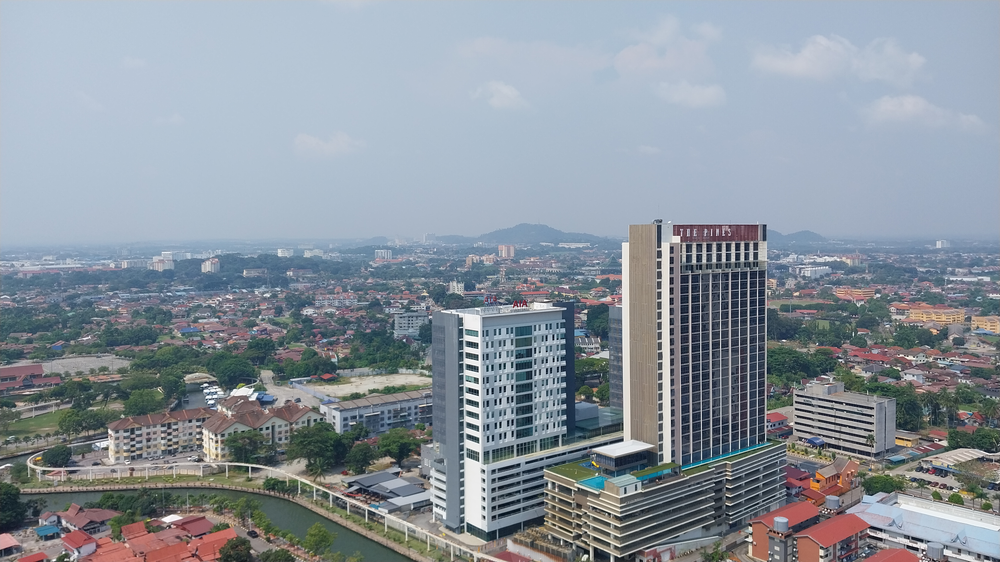

**Output Image**

input shape torch.Size([1, 3, 253, 450])
inference time took 1.509983777999878 s


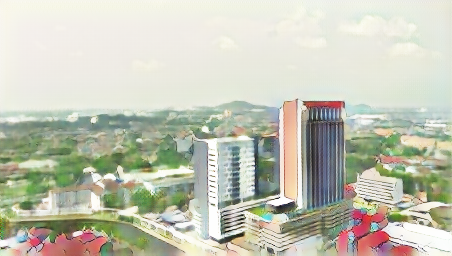

In [5]:
output450 = transform(models, "Hosoda", path, load_size=450)
output450

## Example 2 (Hayao)

In [6]:
path = "/Users/yuyla/Pictures/Memories/5. 2023 January Selangor/20230128_131111.jpg"

**Orginal Image**
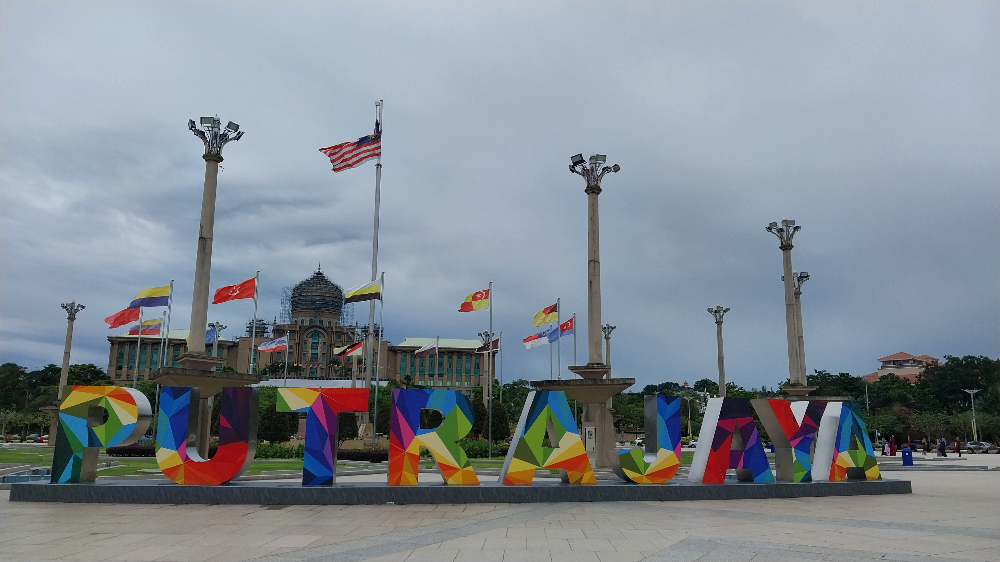

**Output Image**

input shape torch.Size([1, 3, 337, 600])
inference time took 2.9131879806518555 s


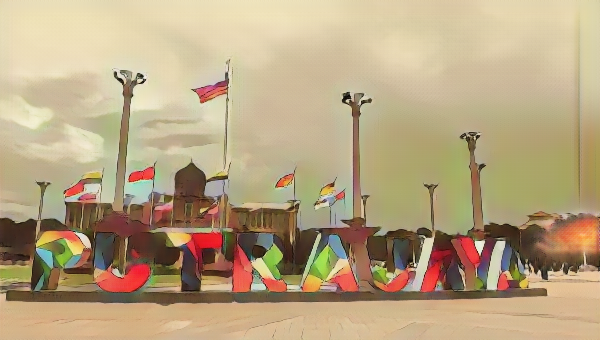

In [7]:
output600 = transform(models, "Hayao", path, load_size=600)
output600

## Example 3 (Shinkai)

In [8]:
path = "/Users/yuyla/Pictures/Memories/7. 2023 May Semester Break/20230520_122747.jpg"

**Original Image**
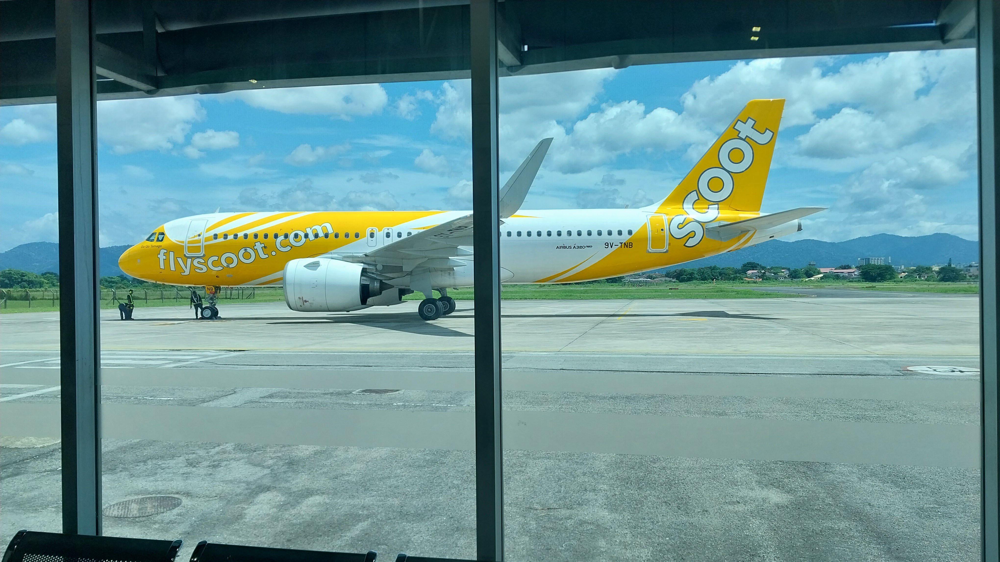

**Output Image**

input shape torch.Size([1, 3, 337, 600])
inference time took 2.6747167110443115 s


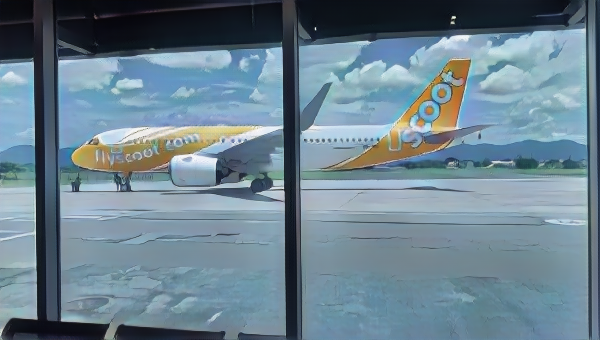

In [9]:
output600 = transform(models, "Shinkai", path, load_size=600)
output600

## Example 4 (Paprika)

In [10]:
path = "/Users/yuyla/Pictures/Memories/5. 2023 January Selangor/20230128_142715.jpg"

**Orginal Image**
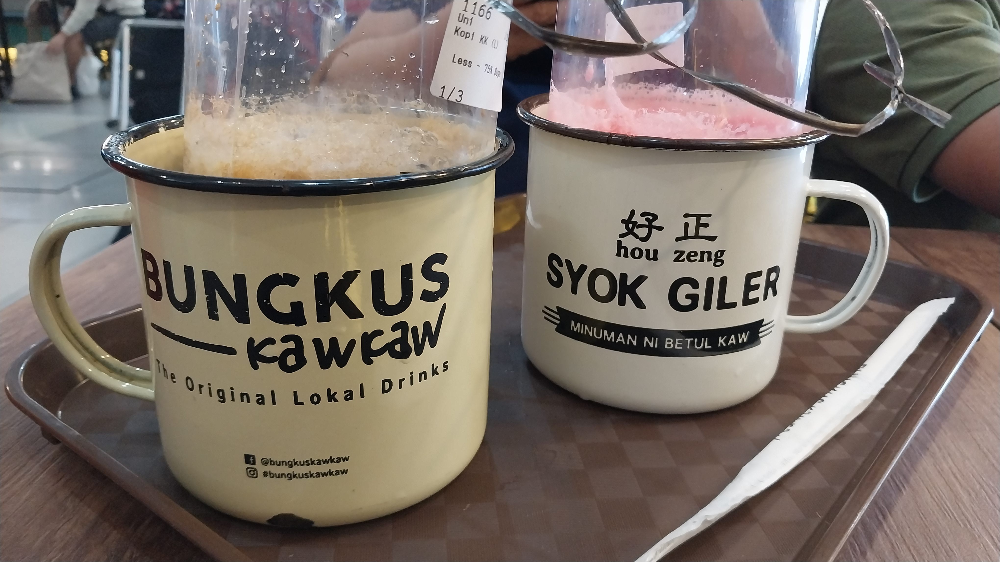

**Output Image**

input shape torch.Size([1, 3, 337, 600])
inference time took 2.8311312198638916 s


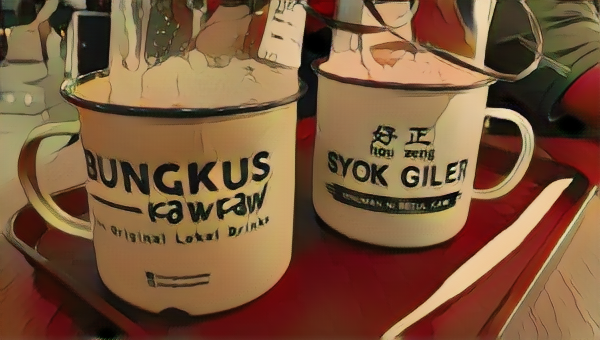

In [11]:
output600 = transform(models, "Paprika", path, load_size=600)
output600